# GG4527- Urban Analytics: A Toolkit for Sustainable Urban Development Assignment 1
##  Lab 2: Data Manipulation and Working with Web Services

-----



### Challenge 1

In [36]:
import numpy as np
import pandas as pd

#1.

#Create two arrays
years = range(2004, 2024) #creates a list of consecutive integers 
a = np.repeat(years, 5) #this uses numpy's repeat() function to repeat values
b = np.random.randint(0, 500, 100) # the randint() function can be used to generate random integers
c = np.random.randint (0, 250, 100)
d = np.random.randint (0, 10, 100)
#Create data frame
df = pd.DataFrame({'a':a,'b':b, 'c':c, 'd':d})  #the curly brackets indicate a dictionary

In [39]:
#2. 

subset_df= df.iloc[:30, :3] # using iloc to subset dataframe

In [44]:

subset_df

,a,b,c
0,2004,208,148
1,2004,104,218
2,2004,269,169
3,2004,305,206
4,2004,213,222
5,2005,116,162
6,2005,52,96
7,2005,441,42
8,2005,360,158
9,2005,369,219


In [54]:
#3. 

df = df.rename(columns={'a': 'Year', 'b': 'Temperature', 'c':'Age'}) # renaming columns a and d

DataFrame_filtered_df= df[(df['Temperature'] > 200)] #filtering column b to only over 200

In [56]:
#4. 
import pandas as pd

mean_values = df.mean() #calculate mean of columns
std_values = df.std() # calculate std of columns

group = df.groupby('Year') #setting groupby year 

group_mean = group.mean() # group mean
group_std = grouped.std() # group stv


print(mean_values)
print(std_values)
print(group_mean)
print(group_std)

Mean of all columns:
Year           2013.50
Age             258.91
Age             126.40
Temperature       4.53
dtype: float64

Standard Deviation of all columns:
Year             5.795331
Age            153.724080
Age             72.830508
Temperature      2.879587
dtype: float64

Mean values per 'Category' group:
        Age    Age  Temperature
Year                           
2004  219.8  192.6          6.6
2005  267.6  135.4          4.2
2006   87.0  123.0          5.6
2007  298.0  135.2          5.6
2008  301.4  106.0          4.2
2009  280.6  118.6          3.4
2010  263.0   98.4          3.8
2011  164.0   99.2          4.2
2012  222.8   99.6          2.0
2013  211.4  117.0          4.0
2014  344.8  151.8          3.4
2015  265.0   98.2          6.4
2016  360.4  142.8          3.6
2017  287.6  127.4          5.4
2018  224.4   79.4          4.6
2019  147.2   72.2          6.6
2020  284.6  166.2          4.4
2021  318.2  137.4          4.2
2022  398.6  158.0          3.6
2023  231.

### Challenge 2

In [17]:
# Part 1

import requests
import pandas as pd
import geopandas as gpd

url_bikes = "https://api.glasgow.gov.uk/mobility/v1/get_rentals?startDate=2022-05-01&endDate=2023-05-01"
# Making the query to the web server, using the Get method from the requests library 
response = requests.get(url_bikes)

data = response.json()
rental_data = data['data']

rental_pd = pd.DataFrame(rental_data)

clean_rental_pd = rental_pd.dropna(subset=['startPlaceLat', 'startPlaceLong', 'endPlaceLat','endPlaceLong'])
clean_rental_pd.info() 

gdf_bikes_end = gpd.GeoDataFrame(clean_rental_pd, geometry=gpd.points_from_xy(clean_rental_pd['endPlaceLong'], clean_rental_pd['endPlaceLat']))


<class 'pandas.core.frame.DataFrame'>
Index: 9940 entries, 0 to 9999
Data columns (total 24 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   created                  9940 non-null   object 
 1   updated                  9940 non-null   object 
 2   cityId                   9940 non-null   object 
 3   bikeId                   9940 non-null   object 
 4   startDate                9940 non-null   object 
 5   startPlaceId             9940 non-null   object 
 6   startPlaceCityId         9940 non-null   object 
 7   startPlaceName           9940 non-null   object 
 8   startPlaceStationNumber  9555 non-null   float64
 9   startPlaceLat            9940 non-null   float64
 10  startPlaceLong           9940 non-null   float64
 11  startChannelId           0 non-null      object 
 12  endDate                  9940 non-null   object 
 13  endPlaceId               9940 non-null   object 
 14  endPlaceCityId           9940

In [19]:
gdf_bikes_end.explore() # this produces cluster outcome with no map 

In [21]:
gdf_bikes_end = gdf_bikes_end.set_crs("EPSG:4326")

gdf_bikes_end.endPlaceId = gdf_bikes_end.endPlaceId.astype(int)
gdf_bikes_end.endPlaceName = gdf_bikes_end.endPlaceName.astype(str)
gdf_bikes_end['endDate'] = pd.to_datetime(gdf_bikes_end['endDate'], format='%Y-%m-%dT%H:%M:%SZ')

In [22]:
from sklearn.cluster import KMeans
num_clusters = 4

kmeans_collection = KMeans(n_clusters=num_clusters, random_state=42)
gdf_bikes_end['kmeans_cluster'] = kmeans_collection.fit_predict(gdf_bikes_end[['endPlaceLong', 'endPlaceLat']])

In [24]:
import leafmap

m = leafmap.Map(center=(55.860166, -4.257505),
                zoom=12,
                draw_control=False,
                measure_control=False,
                fullscreen_control=False,
                attribution_control=True,
                   
               )

m.add_basemap("CartoDB.Positron")
m.add_data(
    gdf_bikes_end,
    column='kmeans_cluster',
    legend_title='Clusters',
    cmap='Set1',
    k=4,
)

#Ploting the map
m

Map(center=[55.860166, -4.257505], controls=(AttributionControl(options=['position', 'prefix'], position='bott…

In [7]:
# Part 2 

import requests
import pandas as pd
import geopandas as gpd

#1. 
url= "http://api.glasgow.gov.uk/traffic/v1/movement/sites" # creating url link to gather data
response = requests.get(url) #fetching data using request.get
response # this will tells us if the data has been recieved correctly


<Response [200]>

In [8]:
data = response.json() # converting to json to succesful manipulate data
data # data is a dictionary so a list must be created

[{'siteId': 'GH020A_B',
  'from': {'description': 'Gallowgate west to Sword St',
   'lat': '55.8543754827825',
   'long': '-4.217259197086495'},
  'to': {'description': 'Gallowgate west to Sword St',
   'lat': '55.854434529999814',
   'long': '-4.216974959509279'}},
 {'siteId': 'GJ3301_D',
  'from': {'description': 'Carmunnock Rd southbound',
   'lat': '55.821736212748405',
   'long': '-4.2561270616272875'},
  'to': {'description': 'Carmunnock Rd southbound',
   'lat': '55.82105417976632',
   'long': '-4.25607160697339'}},
 {'siteId': 'GH020A_A',
  'from': {'description': 'Gallowgate east to Sword St',
   'lat': '55.85539015389372',
   'long': '-4.225769520669405'},
  'to': {'description': 'Gallowgate east to Sword St',
   'lat': '55.85526881737797',
   'long': '-4.2260182328994995'}},
 {'siteId': 'GJ3301_C',
  'from': {'description': 'Carmunnock Rd northbound to Kings Park Avenue',
   'lat': '55.81925458152306',
   'long': '-4.255696036412074'},
  'to': {'description': 'Carmunnock Rd 

In [9]:
sensor_data = [] # creating list to extract information to
    
for sensor in data:  # creating loop
    siteId = sensor['siteId']  #extracting siteid

    from_lat = float(sensor['from']['lat']) #extracting long and lat
    from_lon = float(sensor['from']['long'])
    to_lat = float(sensor['to']['lat'])
    to_lon = float(sensor['to']['long'])
    
    #adding data to the list using append
    sensor_data.append({
        'siteId': siteId,
        'from_description': sensor['from']['description'],
        'to_description': sensor['to']['description'],
        'from_lat': from_lat,
        'from_lon': from_lon,
        'to_lat': to_lat,
        'to_lon': to_lon,
        
    })


In [75]:
sensor_df= pd.DataFrame(sensor_data) #turning the list into df
sensor_df

,siteId,from_description,to_description,from_lat,from_lon,to_lat,to_lon,from_point,to_point
0,GH020A_B,Gallowgate west to Sword St,Gallowgate west to Sword St,55.854375,-4.217259,55.854435,-4.216975,POINT (-4.248499802037326 55.85969518557228),POINT (-4.248542105351628 55.85987416120498)
1,GJ3301_D,Carmunnock Rd southbound,Carmunnock Rd southbound,55.821736,-4.256127,55.821054,-4.256072,POINT (-4.248499802037326 55.85969518557228),POINT (-4.248542105351628 55.85987416120498)
2,GH020A_A,Gallowgate east to Sword St,Gallowgate east to Sword St,55.855390,-4.225770,55.855269,-4.226018,POINT (-4.248499802037326 55.85969518557228),POINT (-4.248542105351628 55.85987416120498)
3,GJ3301_C,Carmunnock Rd northbound to Kings Park Avenue,Carmunnock Rd northbound to Kings Park Avenue,55.819255,-4.255696,55.818491,-4.255684,POINT (-4.248499802037326 55.85969518557228),POINT (-4.248542105351628 55.85987416120498)
4,GJ3301_B,Kings Park Ave westbound to Carmunnock Rd,Kings Park Ave westbound to Carmunnock Rd,55.820288,-4.250775,55.820163,-4.250273,POINT (-4.248499802037326 55.85969518557228),POINT (-4.248542105351628 55.85987416120498)
...,...,...,...,...,...,...,...,...,...
1270,GL1851_S,PRW from tweedsmuir w/b,PRW from tweedsmuir w/b,55.845768,-4.355396,55.845522,-4.359823,POINT (-4.248499802037326 55.85969518557228),POINT (-4.248542105351628 55.85987416120498)
1271,GJ011A_V,Aikenhead Road northbound to Dixon Rd,Aikenhead Road northbound to Dixon Rd,55.831699,-4.248512,55.831509,-4.248565,POINT (-4.248499802037326 55.85969518557228),POINT (-4.248542105351628 55.85987416120498)
1272,GA4771_V,Glassford Street Northbound,Glassford Street Northbound,55.857649,-4.249340,55.857411,-4.249087,POINT (-4.248499802037326 55.85969518557228),POINT (-4.248542105351628 55.85987416120498)
1273,GJ011A_T,Aikenhead Road southbound to Dixon Rd,Aikenhead Road southbound to Dixon Rd,55.835227,-4.248748,55.835573,-4.249007,POINT (-4.248499802037326 55.85969518557228),POINT (-4.248542105351628 55.85987416120498)


In [107]:
#2.
# maping the sensors using folium 

import folium

m = folium.Map(location=[55.860166, -4.257505], zoom_start=12) # map centred on glasgow

# Add sensors to the map as blue markers
for _, row in sensor_df.iterrows():
    folium.Marker(
        location=[row['from_lat'], row['from_lon']],
        popup=row['siteId']
    ).add_to(m)

# Display the map
m

# (GeoPandas, 2023a)

screenshot

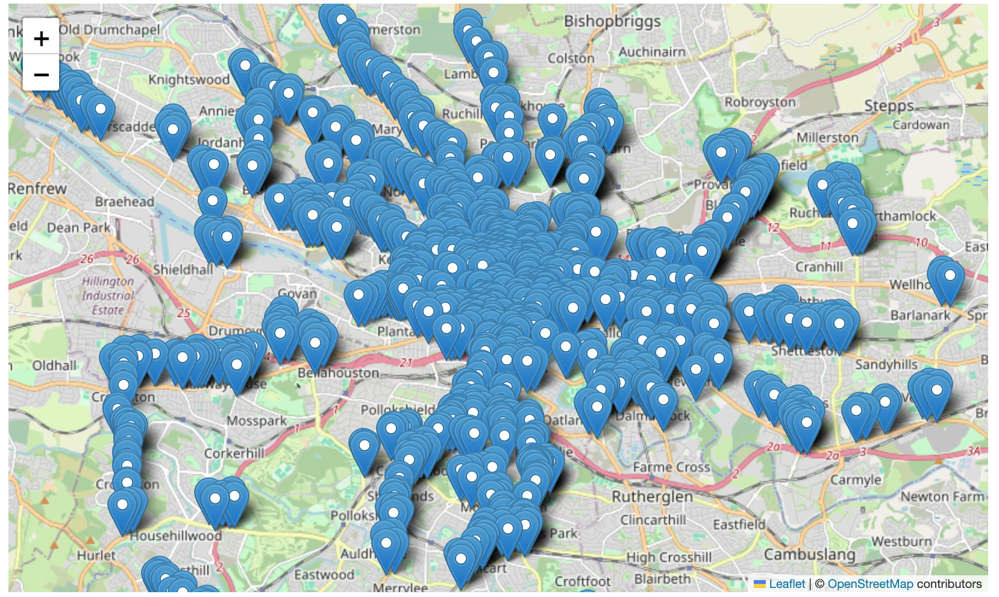


In challenge 2, part 2, I originally tried to plot the map of the sensors using leafmap. I had many issues with this, particulary with making the data compatable with a Json. Because leafmap is not able to use point geometries directly I was trying to convert this to a json file to then use leafmap. However, ever after setting the crs, the json file could still not read into leafmap. After this I tried other options like using geopandas directly but I recieved similar errors about the crs setting. Then I opted to use folium instead. I had assumed that this also wouldn't work as similary to leafmap, folium does not use point geometries. However, after using GeoPandas (2023a) and through a little trial and error the map eventually worked. I am still slightly unsure of where I went wrong with leafmap but found folium to be a much easier method. 

In [125]:
# 3. Working Zones

m = leafmap.Map(
    center=(56.329031,-3.798943),
    zoom=7
) # creating leaf map
wms_url = 'https://maps.gov.scot/server/services/NRS/Census2011/MapServer/WMSServer?' # adding data from census


m.add_wms_layer(url=wms_url, layers='WorkplaceZones2011', name='Census2011', shown=True)
m # creates map of Scotland with workplace zones 


Map(center=[56.329031, -3.798943], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title',…

In [23]:
from owslib.wfs import WebFeatureService

#reading url
wfs_url = 'https://maps.gov.scot/server/services/NRS/Census2011/MapServer/WFSServer?request=GetCapabilities&service=WFS'

wfs = WebFeatureService(url=wfs_url, version='1.0.0') #connect to WFS

layers = wfs.contents
print("Available layers:", layers) # working out what layer to use for working zones 'CEN2011:WorkplaceZones2011'

Available layers: {'CEN2011:PostcodeGridRef2011': <owslib.feature.wfs100.ContentMetadata object at 0x130f93350>, 'CEN2011:PostcodeUnit2011': <owslib.feature.wfs100.ContentMetadata object at 0x130fadf10>, 'CEN2011:OutputAreaCent2011': <owslib.feature.wfs100.ContentMetadata object at 0x130dfd9d0>, 'CEN2011:OutputArea2011': <owslib.feature.wfs100.ContentMetadata object at 0x131029fd0>, 'CEN2011:LCSector2011': <owslib.feature.wfs100.ContentMetadata object at 0x131039610>, 'CEN2011:DCSector2011': <owslib.feature.wfs100.ContentMetadata object at 0x131624e90>, 'CEN2011:IslandGroups2011': <owslib.feature.wfs100.ContentMetadata object at 0x131625c10>, 'CEN2011:WorkplaceZones2011': <owslib.feature.wfs100.ContentMetadata object at 0x131625d90>}


In [26]:
# data taken from https://www.spatialdata.gov.scot/geonetwork/srv/eng/catalog.search#/metadata/ff882746-e913-4f78-862e-f6e3974fb80e
import requests
import geojson

# setting url
url = "https://maps.gov.scot/server/services/NRS/Census2011/MapServer/WFSServer?request=GetCapabilities&service=WFS"

params = { # adding parameters
    "service": "WFS",
    "version": "2.0.0",  
    "request": "GetFeature",
    "typeName": "CEN2011:WorkplaceZones2011",  # inserting layer name
    "outputFormat": "Geojson"  #requesting Geojson
}

response = requests.get(url, params=params) # getting request

work_zones_gdf = gpd.GeoDataFrame.from_features(geojson.loads(response.content), crs="EPSG:27700") 
# we now have our gdf for working zones in scotland 

# (Python GIS Book, 2023)


In [10]:
import geopandas as gpd

sensor_gdf= gpd.GeoDataFrame(sensor_data) 
sensor_gdf # and this is our gdf for sensors



,siteId,from_description,to_description,from_lat,from_lon,to_lat,to_lon
0,GH020A_B,Gallowgate west to Sword St,Gallowgate west to Sword St,55.854375,-4.217259,55.854435,-4.216975
1,GJ3301_D,Carmunnock Rd southbound,Carmunnock Rd southbound,55.821736,-4.256127,55.821054,-4.256072
2,GH020A_A,Gallowgate east to Sword St,Gallowgate east to Sword St,55.855390,-4.225770,55.855269,-4.226018
3,GJ3301_C,Carmunnock Rd northbound to Kings Park Avenue,Carmunnock Rd northbound to Kings Park Avenue,55.819255,-4.255696,55.818491,-4.255684
4,GJ3301_B,Kings Park Ave westbound to Carmunnock Rd,Kings Park Ave westbound to Carmunnock Rd,55.820288,-4.250775,55.820163,-4.250273
...,...,...,...,...,...,...,...
1270,GL1851_S,PRW from tweedsmuir w/b,PRW from tweedsmuir w/b,55.845768,-4.355396,55.845522,-4.359823
1271,GJ011A_V,Aikenhead Road northbound to Dixon Rd,Aikenhead Road northbound to Dixon Rd,55.831699,-4.248512,55.831509,-4.248565
1272,GA4771_V,Glassford Street Northbound,Glassford Street Northbound,55.857649,-4.249340,55.857411,-4.249087
1273,GJ011A_T,Aikenhead Road southbound to Dixon Rd,Aikenhead Road southbound to Dixon Rd,55.835227,-4.248748,55.835573,-4.249007


In [18]:
# joining the two gdf 

import geopandas as gpd
from shapely.geometry import Point

sensor_gdf['geometry'] = sensor_gdf.apply(lambda row: Point(row['from_lon'], row['from_lat']), axis=1)
# as my sensor gdf doesnt have a geometry column add one manually

sensor_gdf = sensor_gdf.set_geometry('geometry') #activating this geometry column

sensor_gdf = sensor_gdf.set_crs("EPSG:4326", allow_override=True) 
work_zones_gdf = work_zones_gdf.set_crs("EPSG:4326", allow_override=True) # setting the same co system for each gdf

joined_gdf = gpd.sjoin(sensor_gdf, work_zones_gdf, how='left', op='within') # using spatial join

print(joined_gdf.head())

# (GeoPandas, 2023b) & (Shapely, 2023)


/var/folders/3y/r3wpbyvn1yl64h2tftjldyf40000gn/T/ipykernel_70636/2907570101.py:5: FutureWarning: You are adding a column named 'geometry' to a GeoDataFrame constructed without an active geometry column. Currently, this automatically sets the active geometry column to 'geometry' but in the future that will no longer happen. Instead, either provide geometry to the GeoDataFrame constructor (GeoDataFrame(... geometry=GeoSeries()) or use `set_geometry('geometry')` to explicitly set the active geometry column.
  sensor_gdf['geometry'] = sensor_gdf.apply(lambda row: Point(row['from_lon'], row['from_lat']), axis=1)
/Users/Lynsey/miniforge3/envs/ua/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3517: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


     siteId                               from_description  \
0  GH020A_B                    Gallowgate west to Sword St   
1  GJ3301_D                       Carmunnock Rd southbound   
2  GH020A_A                    Gallowgate east to Sword St   
3  GJ3301_C  Carmunnock Rd northbound to Kings Park Avenue   
4  GJ3301_B      Kings Park Ave westbound to Carmunnock Rd   

                                  to_description   from_lat  from_lon  \
0                    Gallowgate west to Sword St  55.854375 -4.217259   
1                       Carmunnock Rd southbound  55.821736 -4.256127   
2                    Gallowgate east to Sword St  55.855390 -4.225770   
3  Carmunnock Rd northbound to Kings Park Avenue  55.819255 -4.255696   
4      Kings Park Ave westbound to Carmunnock Rd  55.820288 -4.250775   

      to_lat    to_lon                   geometry  index_right GmlID  \
0  55.854435 -4.216975  POINT (-4.21726 55.85438)          NaN   NaN   
1  55.821054 -4.256072  POINT (-4.25613 55.8

In [21]:
import folium
import geopandas as gpd
from folium import plugins
from shapely.geometry import Point

work_zones_gdf = work_zones_gdf.to_crs("EPSG:4326") #setting same crs
joined_gdf = joined_gdf.to_crs("EPSG:4326")

m = folium.Map(location=[55.860166, -4.257505], zoom_start=12) # use folium for map

for _, row in work_zones_gdf.iterrows(): # adding workzones as polygons
    # Create polygon for each work zone
    folium.GeoJson(row['geometry'], 
                  name=row['wzcd'], 
                  style_function=lambda x: {'fillColor': 'lightblue', 'color': 'black', 'weight': 1, 'fillOpacity': 0.5}).add_to(m)

for _, row in joined_gdf.iterrows(): # adding sensors
    folium.Marker(
        location=[row['from_lat'], row['from_lon']],  #lat and long of traffic sensor
        popup=row['siteId'],  
        icon=folium.Icon(color='red')
    ).add_to(m)

# create map
m


screenshot 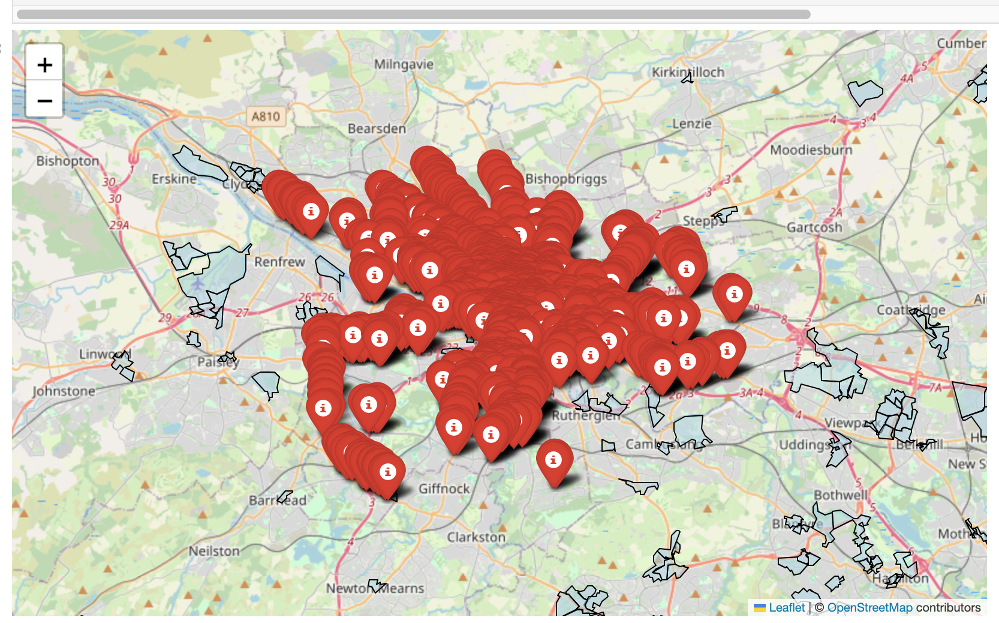


When turning the working zone data into a gdf there were a few small issues. The WFS did not support json conversion. This resulted in me trying numerous other options until it accepted GeoJSON. I wanted to make sure all the data had been correctly combined before clipping the data to glasgow only however noticed not all the polygons had combined. I wanted to do this before clipping as it looked like some of the markers would fall outside the definition of the City of Glasgow. Therefore i would lose some data from the sensor df. Therfore wanted to combine the two before clipping. However, if I were to clip the data now i would use the code: 

glasgow= joined_gdf[joined_gdf["LAName"] == "City of Glasgow"] # extracting wanted data

Due to the failure of the join I was unable to calculate what working zone has the most sensors. 


References:

GeoPandas. (2023a). Plotting with Folium. Available at: https://geopandas.org/en/stable/gallery/plotting_with_folium.html (Accessed: 24 February 2025).

Python GIS Book. (2023). Retrieving Data from WFS. Available at: https://python-gis-book.readthedocs.io/en/latest/part2/chapter-09/nb/01-retrieving-data-from-wfs.html (Accessed: 24 February 2025).

Shapely. (2023). Shapely Documentation: Geometry. Available at: https://shapely.readthedocs.io/en/stable/geometry.html (Accessed: 24 February 2025).


GeoPandas. (2023b). GeoPandas Documentation: sjoin. Available at: https://geopandas.org/en/stable/docs/reference/api/geopandas.sjoin.html (Accessed: 24 February 2025).
